<a href="https://colab.research.google.com/github/kruedae/Photoelasticity/blob/master/Informe_Optica.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Polarización



In [ ]:
# Leyendo las imagenes desde los Google drive
GOOGLE_DRIVE = '/content/google_drive'
import numpy as np
from google.colab import drive
drive.mount(GOOGLE_DRIVE)

Mounted at /content/google_drive


In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import numpy as np
import glob

In [ ]:
img_path = GOOGLE_DRIVE+'/MyDrive/optica_imagenes/'
imgs = glob.glob(img_path+'3-*')
print(imgs[0])

/content/google_drive/MyDrive/optica_imagenes/3-1.jpg


### Analisis de la imagen para extraer los puntos de interes

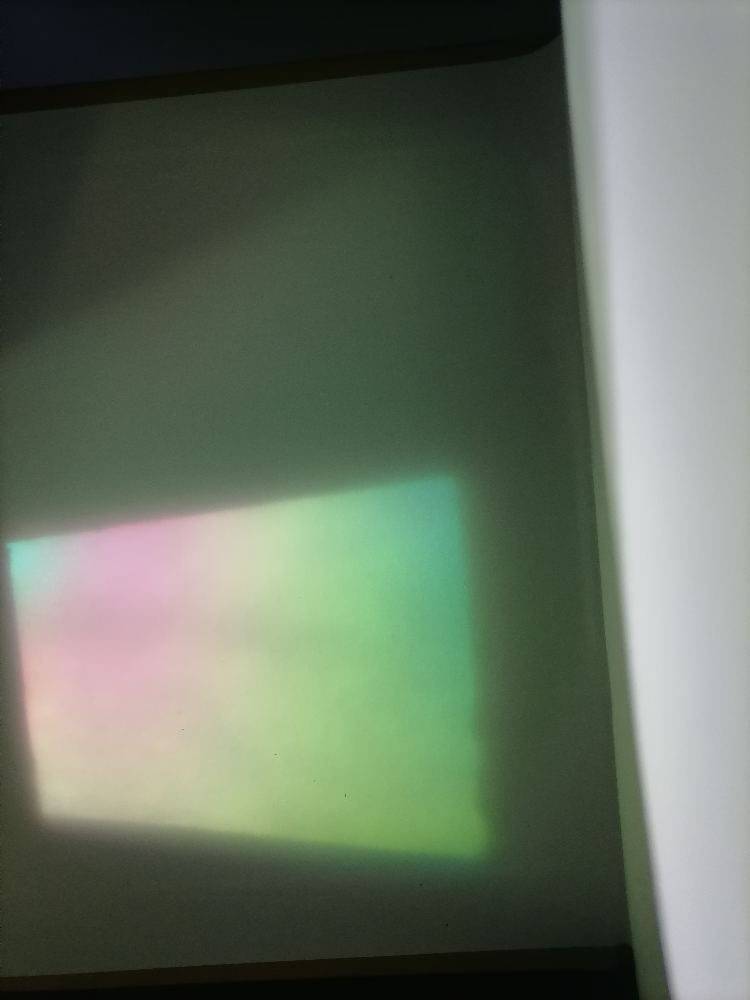

In [ ]:
# Visualizando la imagen completa
img = cv2.imread(imgs[0])
cv2_imshow(img)

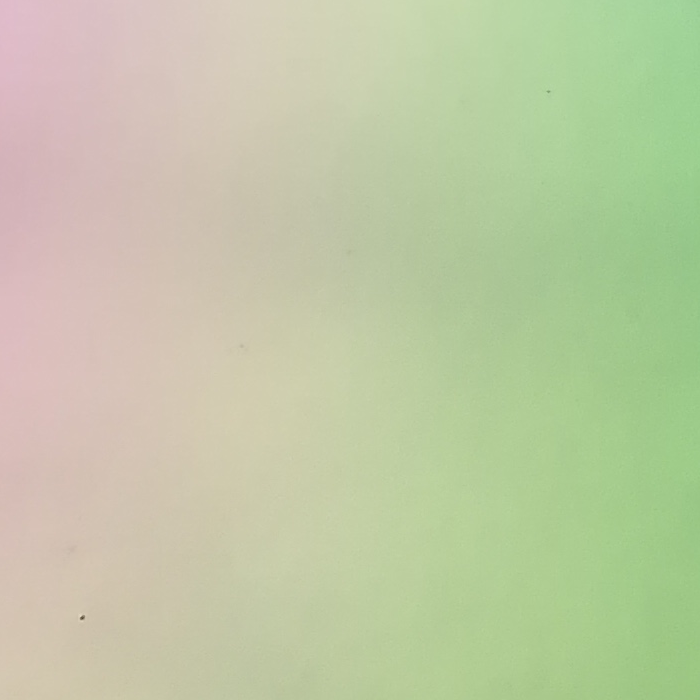

In [ ]:
# Extrayendo los pixeles de interes posterior al analisis
anew_img=img[int(img.shape[0]/2)+300:int(img.shape[0]/2)+1000, int(img.shape[1]/2)-850:int(img.shape[1]/2)-150,:]
cv2_imshow(anew_img)

[[175, 175], [175, 350], [175, 525], [350, 175], [350, 350], [350, 525], [525, 175], [525, 350], [525, 525]]


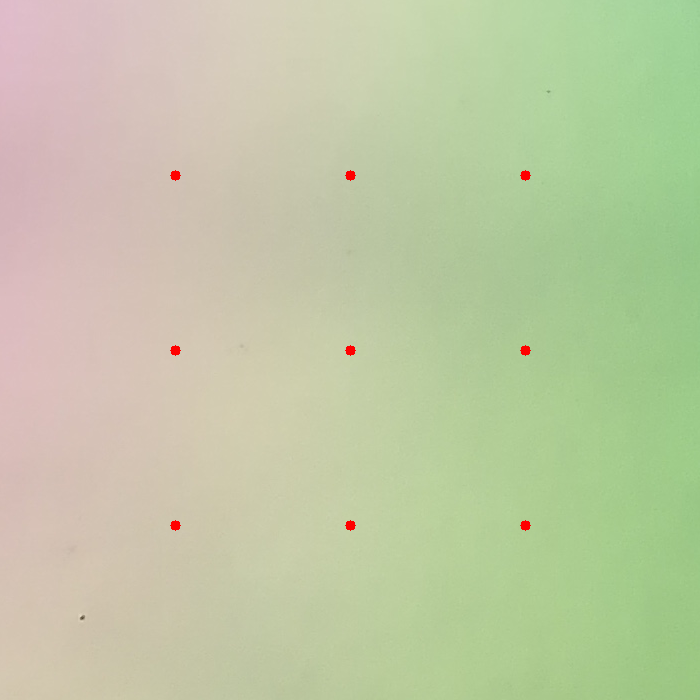

In [ ]:
# Ubicacion y visualizacion de los puntos de interes en la nueva region
pixels = []
for i in range(3):
  for j in range(3):
    l = int(anew_img.shape[0]/4)
    pixels.append([l+i*l, l+j*l])
print(pixels)

for pixel in pixels:
  image2 = cv2.circle(anew_img, (pixel[0], pixel[1]), radius=5, color=(0, 0, 255), thickness=-1)
cv2_imshow(anew_img)
cv2.waitKey(0)
cv2.destroyAllWindows()

### Procesamiento de todas las imagenes

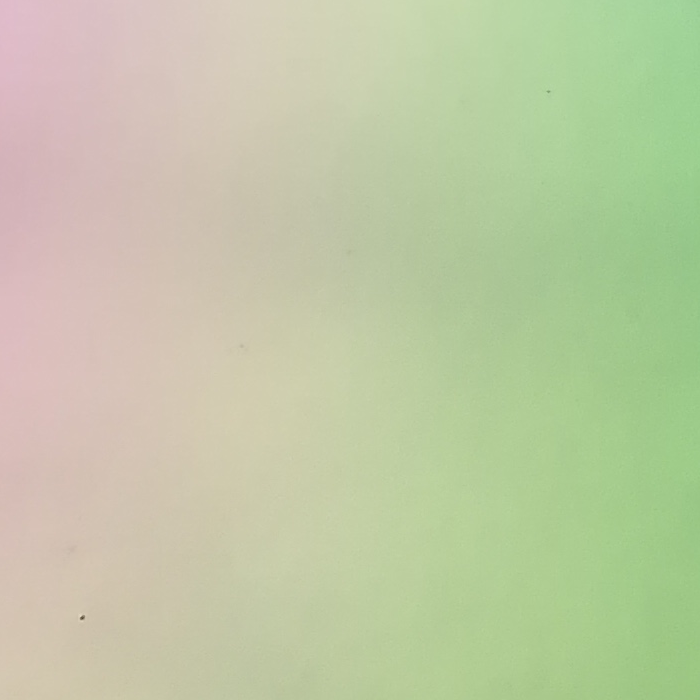

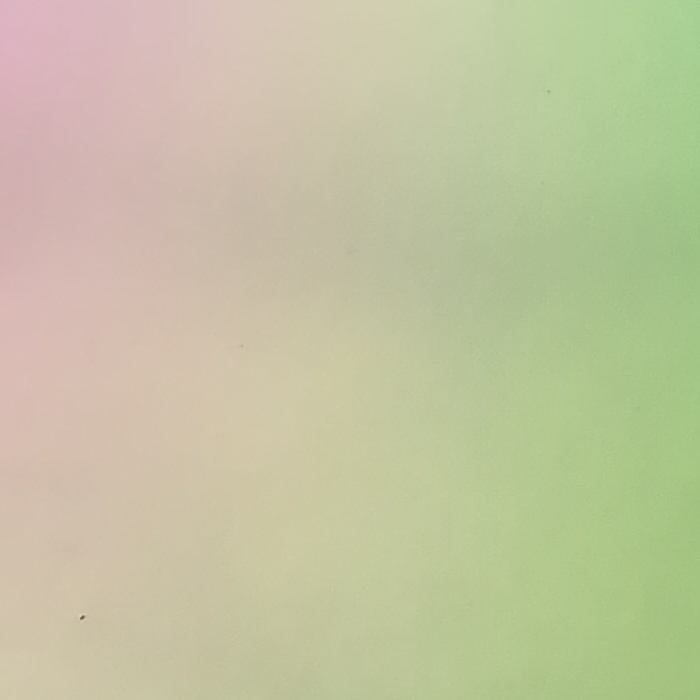

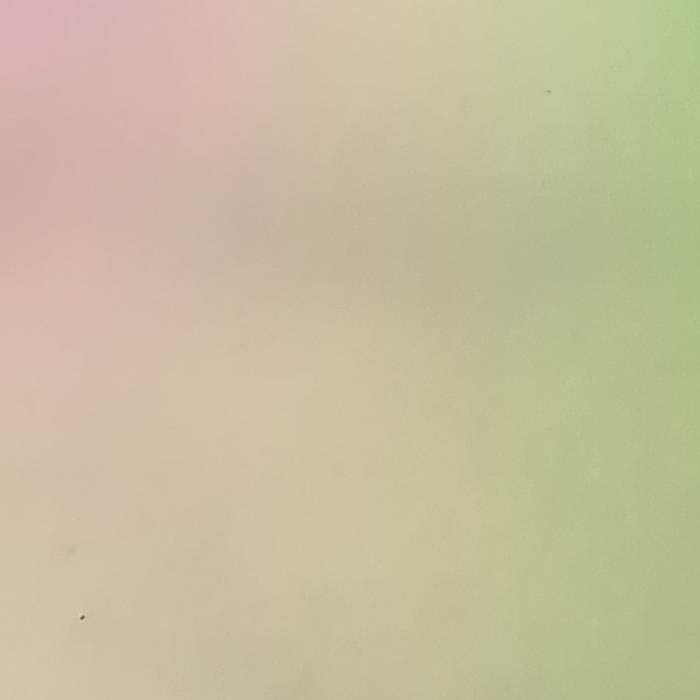

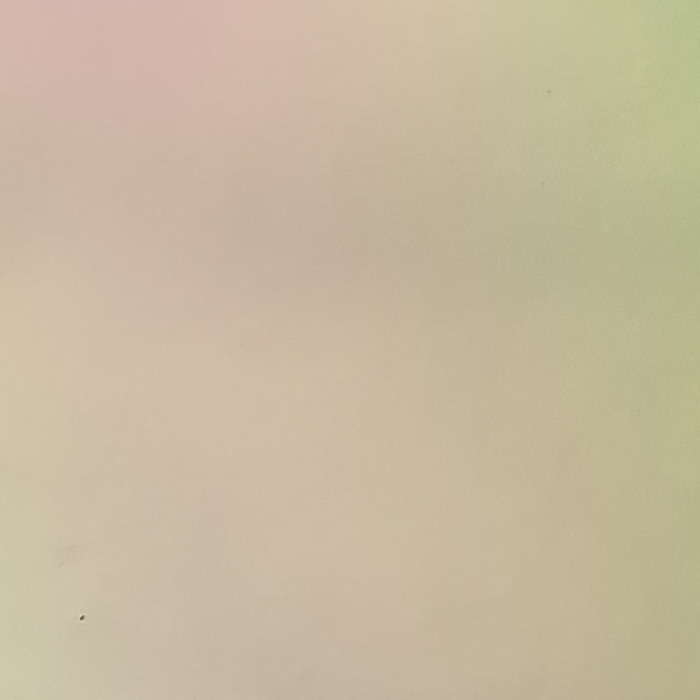

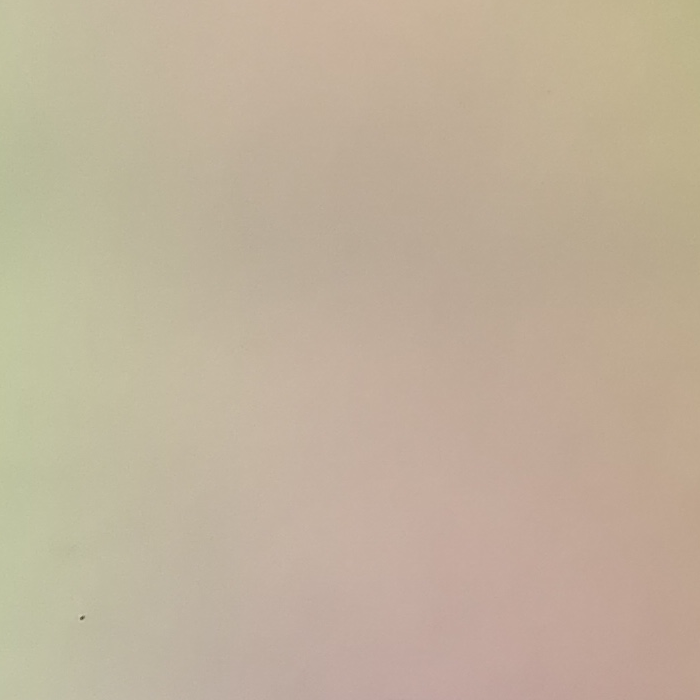

...

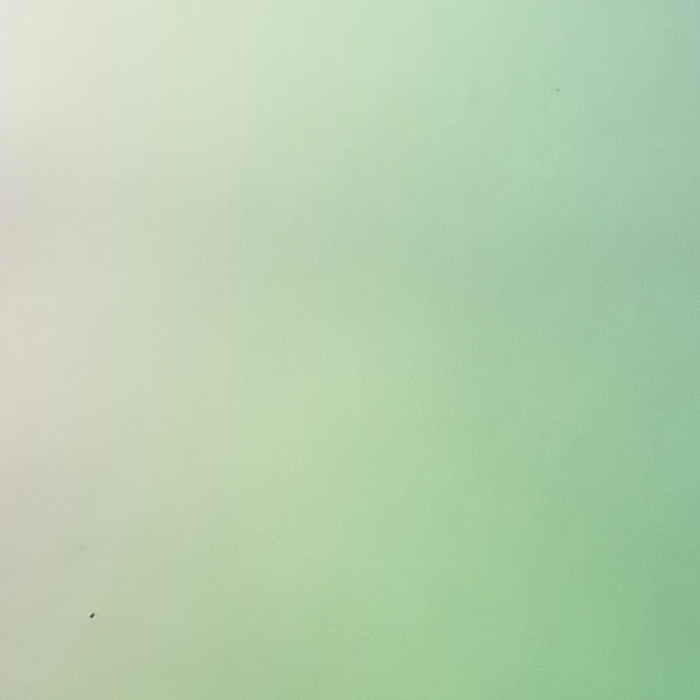

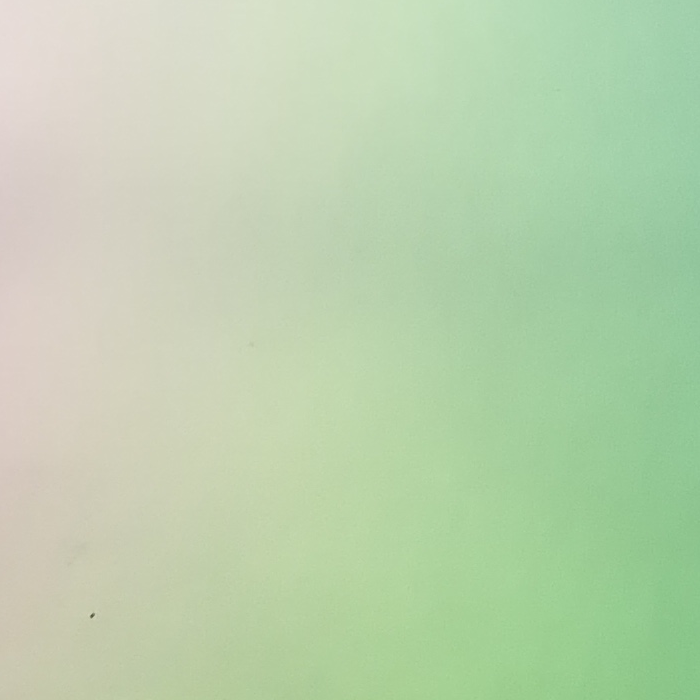

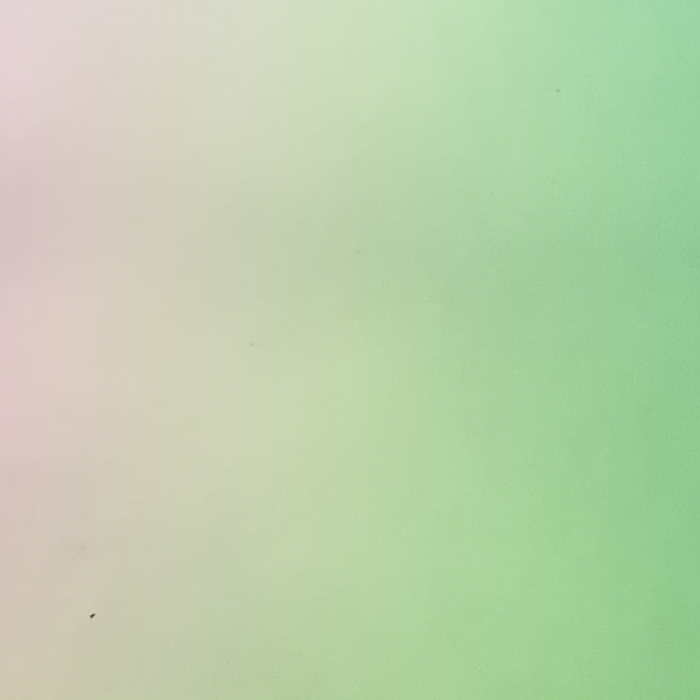

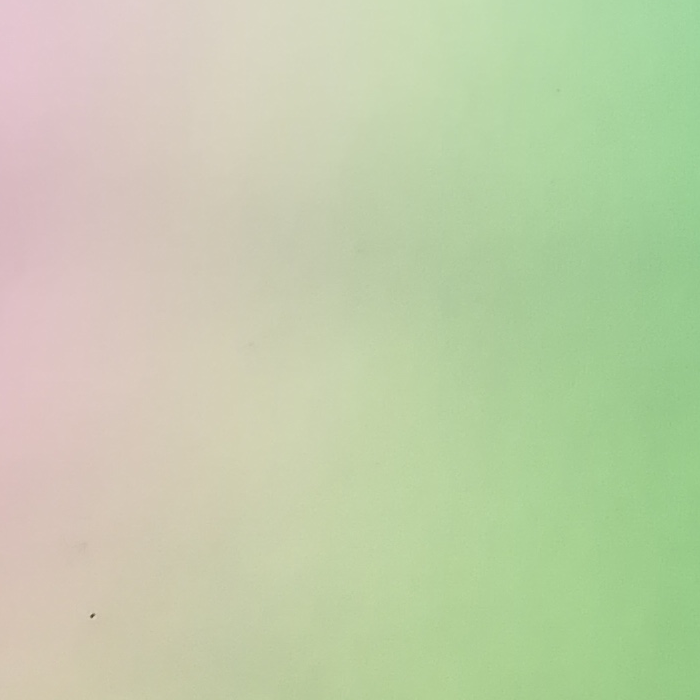

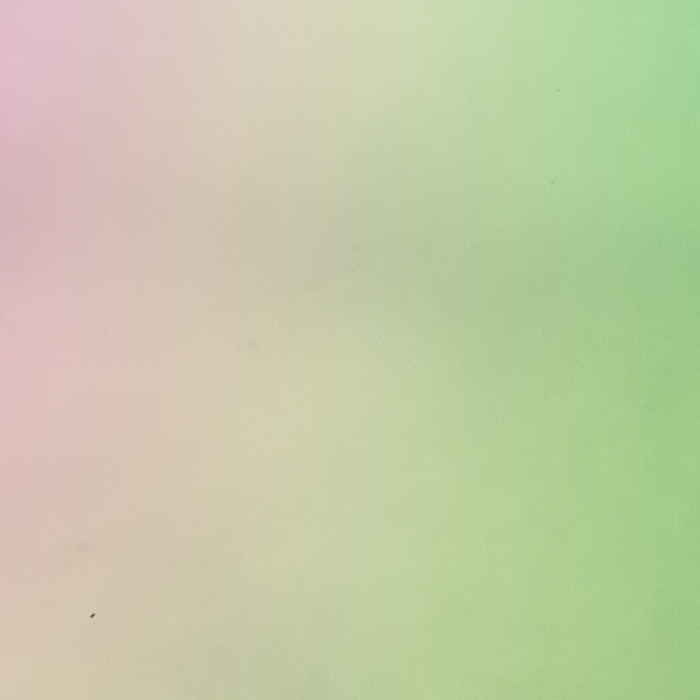

In [ ]:
azul = []
verde = []
rojo = []
for img_path in imgs:
  img = cv2.imread(img_path)
  new_img=img[int(img.shape[0]/2)+300:int(img.shape[0]/2)+1000, int(img.shape[1]/2)-850:int(img.shape[1]/2)-150,:]
  cv2_imshow(new_img)
  aimg, vimg, rimg = [], [], []
  for pixel in pixels:
    va, vv, vr = 0, 0, 0
    for i in range(3):
      for j in range(3):
        va += new_img[pixel[0]+i-1, pixel[1]+j, 0]
        vv += new_img[pixel[0]+i-1, pixel[1]+j, 1]
        vr += new_img[pixel[0]+i-1, pixel[1]+j, 2]
    aimg.append(va/9)
    vimg.append(vv/9)
    rimg.append(vr/9)
  azul.append(aimg)
  verde.append(vimg)
  rojo.append(rimg)
  
azul = np.array(azul)
verde = np.array(verde)
rojo = np.array(rojo)

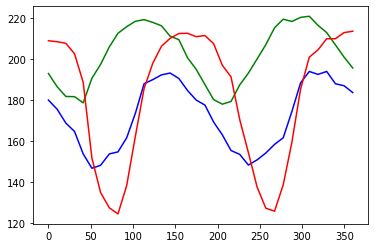

In [ ]:
t = np.linspace(0,2*np.pi,36)
plt.plot(t*180/np.pi,azul[:,0], color='b')
plt.plot(t*180/np.pi,verde[:,0], color='g')
plt.plot(t*180/np.pi,rojo[:,0], color='r')

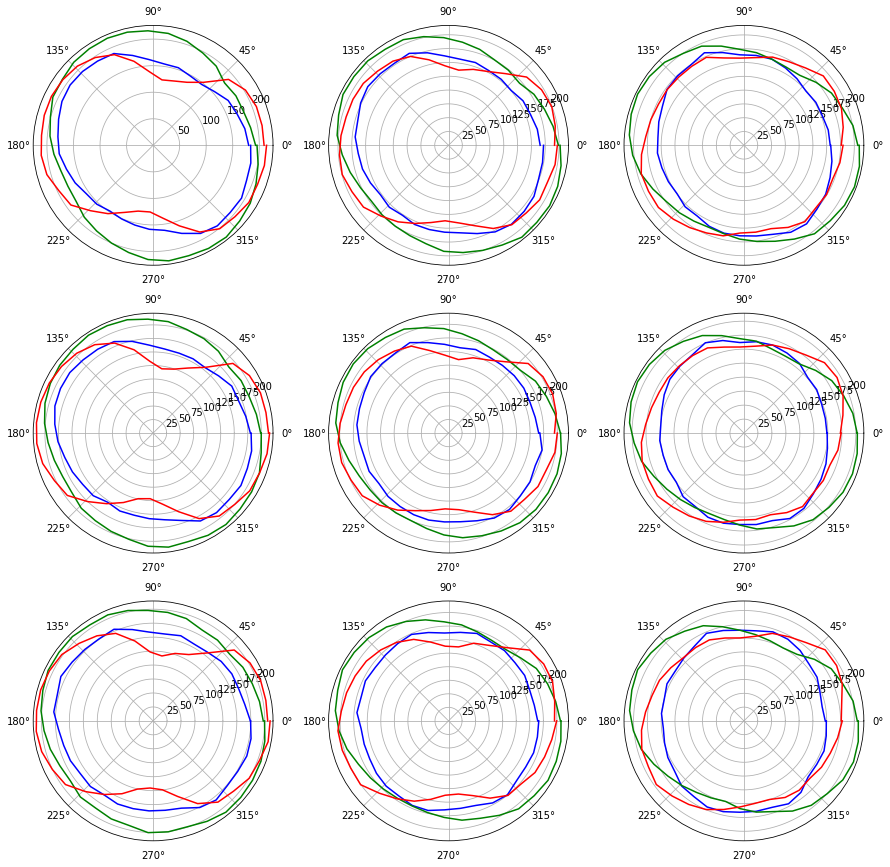

In [ ]:
fig, axs = plt.subplots(3,3, figsize=(15,15), subplot_kw=dict(projection='polar'))
aux = 0
for i in range(3):
  for j in range(3):
    axs[i,j].plot(t, azul[:,aux], color='b')
    axs[i,j].plot(t, verde[:,aux], color='g')
    axs[i,j].plot(t, rojo[:,aux], color='r')
    aux += 1

In [ ]:
for i in range(9):
  print("PUNTO",i+1)
  print("     Emax,     Emin,    e")

  print("Azul", np.max(azul[:,i]), np.min(azul[:,i]),
        np.sqrt(np.max(azul[:,i])**2.0 - np.min(azul[:,i])**2.0)/np.max(azul[:,i]))
  
  print("Verde", np.max(verde[:,i]), np.min(verde[:,i]),
        np.sqrt(np.max(verde[:,i])**2.0 - np.min(verde[:,i])**2.0)/np.max(verde[:,i]))
  
  print("Rojo", np.max(rojo[:,i]), np.min(rojo[:,i]),
        np.sqrt(np.max(rojo[:,i])**2.0 - np.min(rojo[:,i])**2.0)/np.max(rojo[:,i]))
  
  print('\n')

PUNTO 1
     Emax,     Emin,    e
Azul 194.0 146.66666666666666 0.6545557396478171
Verde 221.0 178.0 0.5926910947270592
Rojo 213.66666666666666 124.33333333333333 0.8132580016378299


PUNTO 2
     Emax,     Emin,    e
Azul 182.66666666666666 150.66666666666666 0.5653990286434186
Verde 213.11111111111111 170.66666666666666 0.5988861164161702
Rojo 199.44444444444446 136.66666666666666 0.7283203764014031


PUNTO 3
     Emax,     Emin,    e
Azul 182.33333333333334 149.22222222222223 0.5746441110122668
Verde 214.0 161.0 0.6587790738257796
Rojo 193.0 158.11111111111111 0.5734671522464267


PUNTO 4
     Emax,     Emin,    e
Azul 190.33333333333334 152.88888888888889 0.595616255029464
Verde 216.77777777777777 185.44444444444446 0.5178709739727596
Rojo 216.44444444444446 119.88888888888889 0.8325822467946367


PUNTO 5
     Emax,     Emin,    e
Azul 180.88888888888889 158.0 0.4868880654611381
Verde 216.44444444444446 173.11111111111111 0.6002736875213083
Rojo 204.44444444444446 136.3333333333333

# Ley de Malus

In [ ]:
img_path = GOOGLE_DRIVE+'/MyDrive/optica_imagenes/'
imgs = glob.glob(img_path+'m-*')
print(imgs)

['/content/google_drive/MyDrive/optica_imagenes/m-0.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-36.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-35.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-34.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-33.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-31.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-32.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-30.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-29.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-28.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-27.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-25.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-26.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-24.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-23.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-22.jpg', '/content/google_drive/MyDrive/optica_imagenes/m-20.jpg', '/content/goog

### Analisis de la imagen para extraer los puntos de interes

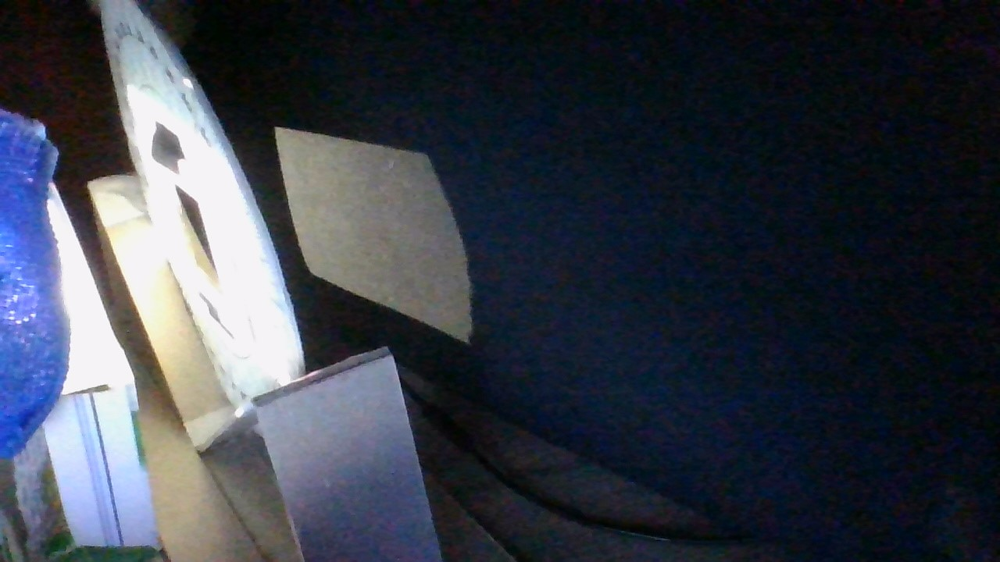

In [ ]:
# Visualizando la imagen completa
img = cv2.imread(imgs[0])
cv2_imshow(img)

In [ ]:
img.shape

(720, 1280, 3)

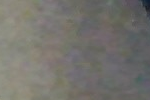

In [ ]:
# Extrayendo los pixeles de interes posterior al analisis
# anew_img=img[int(img.shape[0]/2)-50:int(img.shape[0]/2)+150, int(img.shape[1]/2):int(img.shape[1]/2)+200,:] # Para los malus*
anew_img=img[int(img.shape[0]/2)-150:int(img.shape[0]/2)-50, int(img.shape[1]/2)-250:int(img.shape[1]/2)-100,:]
cv2_imshow(anew_img)

[[25, 25], [25, 50], [25, 75], [50, 25], [50, 50], [50, 75], [75, 25], [75, 50], [75, 75]]


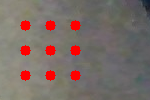

In [ ]:
# Ubicacion y visualizacion de los puntos de interes en la nueva region
pixels = []
for i in range(3):
  for j in range(3):
    l = int(anew_img.shape[0]/4)
    pixels.append([l+i*l, l+j*l])
print(pixels)

for pixel in pixels:
  image2 = cv2.circle(anew_img, (pixel[0], pixel[1]), radius=5, color=(0, 0, 255), thickness=-1)
cv2_imshow(anew_img)
cv2.waitKey(0)
cv2.destroyAllWindows()

### Procesamiento de todas las imagenes

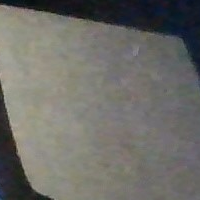

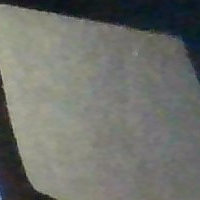

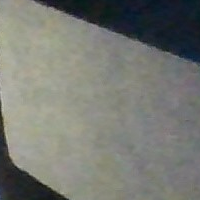

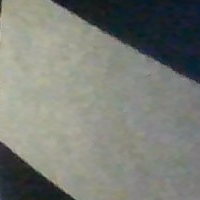

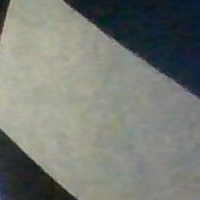

...

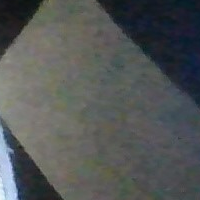

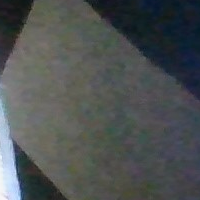

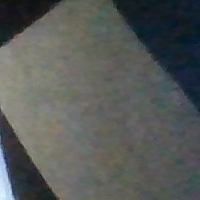

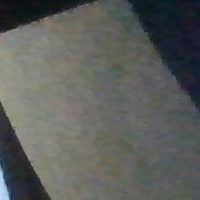

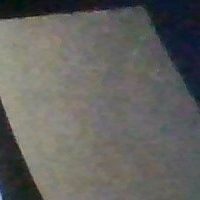

In [ ]:
azul = []
verde = []
rojo = []
img = cv2.imread(imgs[8])
# bkg_img=img[int(img.shape[0]/2)-50:int(img.shape[0]/2)+150, int(img.shape[1]/2):int(img.shape[1]/2)+200,:]
bkg_img = img[int(img.shape[0]/2)-200:int(img.shape[0]/2), int(img.shape[1]/2)-275:int(img.shape[1]/2)-75,:]
for img_path in imgs:
  img = cv2.imread(img_path)
  # new_img=img[int(img.shape[0]/2)-50:int(img.shape[0]/2)+150, int(img.shape[1]/2):int(img.shape[1]/2)+200,:]
  new_img = img[int(img.shape[0]/2)-200:int(img.shape[0]/2), int(img.shape[1]/2)-275:int(img.shape[1]/2)-75,:]
  cv2_imshow(new_img)
  aimg, vimg, rimg = [], [], []
  for pixel in pixels:
    va, vv, vr = 0, 0, 0
    for i in range(3):
      for j in range(3):
        va += new_img[pixel[0]+i-1, pixel[1]+j, 0] #-bkg_img[pixel[0]+i-1, pixel[1]+j, 0]
        vv += new_img[pixel[0]+i-1, pixel[1]+j, 1] #-bkg_img[pixel[0]+i-1, pixel[1]+j, 1]
        vr += new_img[pixel[0]+i-1, pixel[1]+j, 2] #-bkg_img[pixel[0]+i-1, pixel[1]+j, 2]
    aimg.append(va/9)
    vimg.append(vv/9)
    rimg.append(vr/9)
  azul.append(aimg)
  verde.append(vimg)
  rojo.append(rimg)
  
azul = np.array(azul)
verde = np.array(verde)
rojo = np.array(rojo)

In [ ]:
len(azul)

37

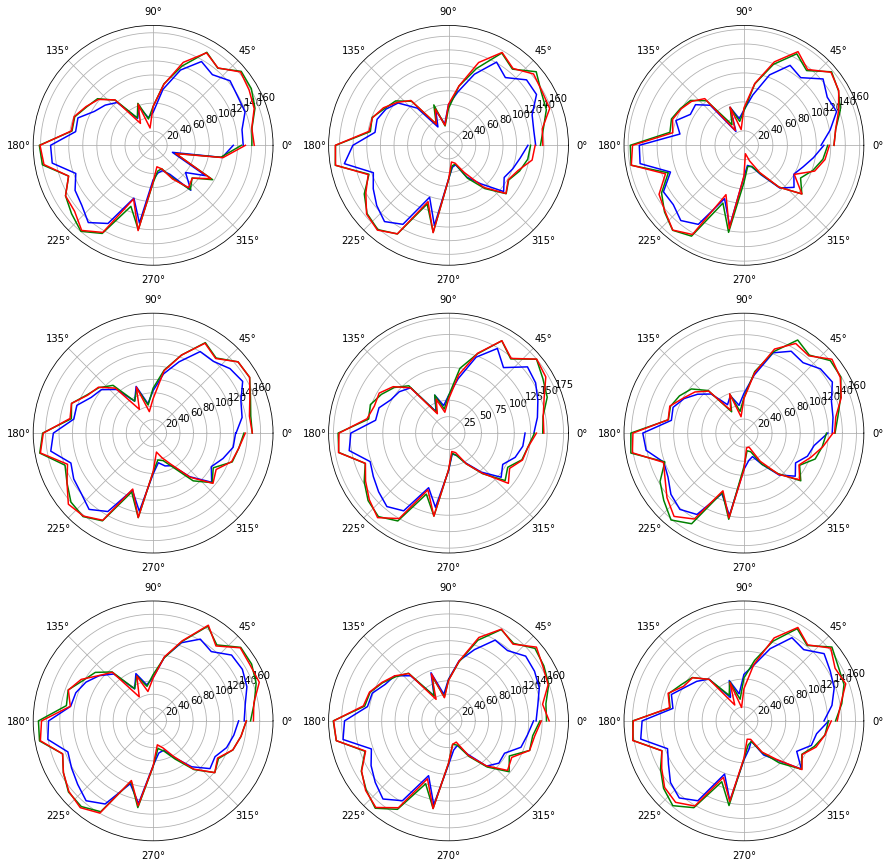

In [ ]:
fig, axs = plt.subplots(3,3, figsize=(15,15), subplot_kw=dict(projection='polar'))
aux = 0
for i in range(3):
  for j in range(3):
    axs[i,j].plot(t, azul[:,aux], color='b')
    axs[i,j].plot(t, verde[:,aux], color='g')
    axs[i,j].plot(t, rojo[:,aux], color='r')
    aux += 1

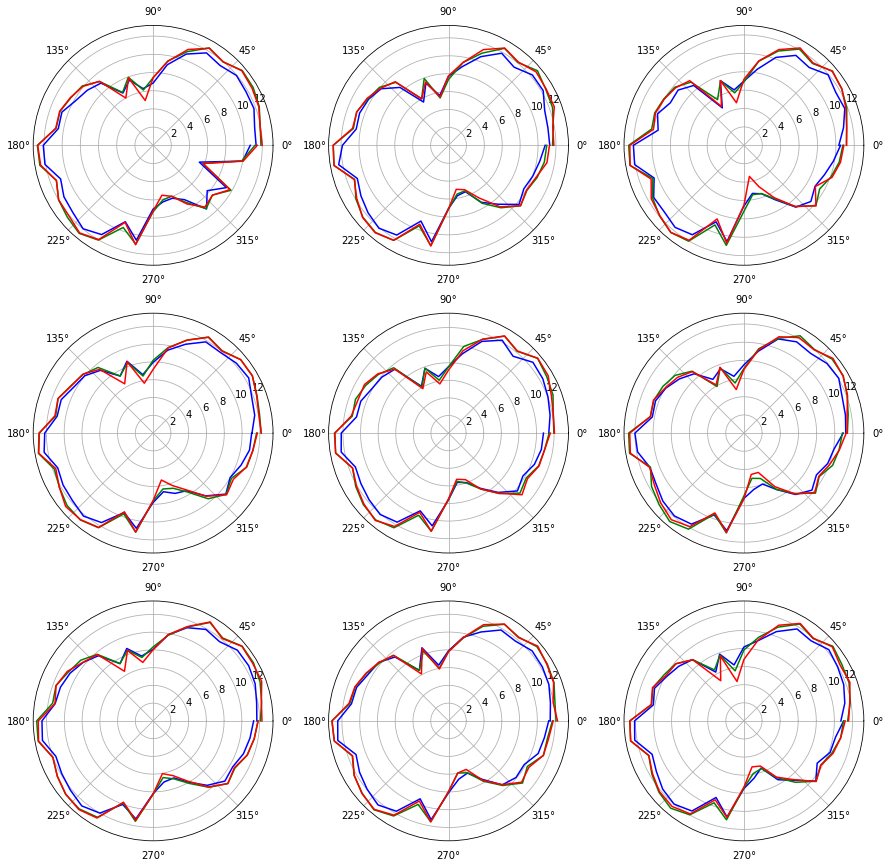

In [ ]:
fig, axs = plt.subplots(3,3, figsize=(15,15), subplot_kw=dict(projection='polar'))
aux = 0
for i in range(3):
  for j in range(3):
    axs[i,j].plot(t, np.sqrt(azul[:,aux]), color='b')
    axs[i,j].plot(t, np.sqrt(verde[:,aux]), color='g')
    axs[i,j].plot(t, np.sqrt(rojo[:,aux]), color='r')
    aux += 1